In [ ]:
import os
from itertools import combinations
import pickle
import numpy as np
import pandas as pd
import scipy
from ete3 import Tree
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [2]:
# Plot template
import plotly.io as pio

pio.templates["custom"] = go.layout.Template(
    layout=go.Layout(
        font_size=20,
        xaxis_mirror=True, yaxis_mirror=True,
        xaxis_rangemode='tozero', yaxis_rangemode='tozero',
        height=500, width=800
    )
)

pio.templates.default = "simple_white+custom"
template_colors = pio.templates[pio.templates.default]['layout']['colorway']

In [3]:
figures_dir = '../fig'

## Load and prepare data

In [4]:
wd = "../output/species_level_analysis/RESULT_euk_new"

In [5]:
intron_len_stats_tsv = os.path.join(wd, 'all_species/intron_lengths.stats')
intron_len_stats_df = pd.read_csv(intron_len_stats_tsv, sep='\t', index_col=0)

In [6]:
def binom_species(s):
    genus, species = s.split('_')[:2]
    return f'{genus}_{species}'

intron_len_stats_df['species'] = intron_len_stats_df.index.to_series().apply(binom_species)

In [7]:
phylum_tsv = "/groups/itay_mayrose_nosnap/liorglic/Projects/intron_evolution/output/species_level_analysis/species_euk_phylum.tsv"
phylum_df = pd.read_csv(phylum_tsv, sep='\t', index_col=0)

In [8]:
intron_len_stats_df['full_name'] = intron_len_stats_df.index
intron_len_stats_df.index = intron_len_stats_df['species']

In [9]:
intron_len_stats_df['log_Genome_size'] = np.log10(intron_len_stats_df['Genome_size'])

In [10]:
intron_len_stats_df = intron_len_stats_df.join(phylum_df, how='outer')

In [11]:
intron_len_stats_all_log_df = intron_len_stats_df.query('Dataset == "all_log"')

In [12]:
phyla_counts = pd.DataFrame(intron_len_stats_all_log_df['phylum'].value_counts())
phyla_counts.head(10)

,count
phylum,
Chordata,255
Arthropoda,112
Streptophyta,97
Ascomycota,43
Mollusca,11
Cnidaria,10
Nematoda,10
Oomycota,8
Apicomplexa,6


In [13]:
# phyla with >= 10 species
phyla10 = phyla_counts.query('count >= 10').index.to_series()

In [14]:
intron_len_stats_all_log_phyla10_df = intron_len_stats_all_log_df.loc[intron_len_stats_all_log_df['phylum'].isin(phyla10)]

In [15]:
intron_len_stats_all_df = intron_len_stats_df.query('Dataset == "all"')
intron_len_stats_all_phyla10_df = intron_len_stats_all_df.loc[intron_len_stats_all_df['phylum'].isin(phyla10)]

In [16]:
intron_len_stats_all_phyla10_df['log_Mean'] = np.log10(intron_len_stats_all_phyla10_df['Mean'])

/var/tmp/pbs.275422.power9.tau.ac.il/ipykernel_13224/248816911.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  intron_len_stats_all_phyla10_df['log_Mean'] = np.log10(intron_len_stats_all_phyla10_df['Mean'])


In [17]:
phy_order = ['Chordata', 'Arthropoda', 'Mollusca', 'Cnidaria', 'Nematoda', 'Ascomycota', 'Streptophyta']

In [18]:
# Create Supp table S1
table_s1 = intron_len_stats_all_phyla10_df[['species', 'full_name', 'phylum', 'Min', 'Max', 'Mean', 'STD', 'Q10', 'Q25', 'Q50', 'Q75', 'Q90','Introns_count', 'Total_intron_length', 'Transcripts_count', 'Total_transcript_length', 'Transcripts_containing_introns', 'Mean_per_transcript', 'Total_intron_fraction', 'Mean_intron_fraction', 'Genome_size']]
table_s1 = pd.concat([table_s1, intron_len_stats_all_log_phyla10_df[['Modes', 'M1_x', 'M1_y', 'M2_x', 'M2_y']]], axis=1)
table_s1.to_csv('Table_S1.tsv', sep='\t', index=False)

## Representative species
Intron length distributions for species representing each phylum

In [19]:
# list of representative species, one from each phylum
represent_spec = ['mus_musculus', 'drosophila_melanogaster', 'stylophora_pistillata',
                 'solanum_lycopersicum', 'biomphalaria_glabrata', 'caenorhabditis_elegans',
                 'tuber_melanosporum']
# sort by phylum order
represent_spec = sorted(represent_spec, key=lambda sp: phy_order.index(phylum_df.loc[sp]['phylum']))
represent_spec_full = [intron_len_stats_all_phyla10_df.loc[sp]['full_name'] for sp in represent_spec]

In [20]:
pd.set_option('display.max_columns', None)
intron_len_stats_all_phyla10_df.loc[represent_spec]

,Min,Max,Mean,STD,Q10,Q25,Q50,Q75,Q90,Modes,M1_x,M1_y,M2_x,M2_y,Introns_count,Total_intron_length,Mean_exon,Transcripts_count,Total_transcript_length,Transcripts_containing_introns,Mean_per_transcript,Mean_total_intron_length_per_transcript,Mean_total_exon_length_per_transcript,Total_intron_fraction,Mean_intron_fraction,mean_first_from_total_intronic_ratio,mean_first_to_max_nonfirst_intron_ratio,perc_first_intron_longest,mean_max_to_min_intron_ratio,mean_max_to_min_intron_ratio_perm_p,Dataset,group,Genome_size,species,full_name,log_Genome_size,phylum,log_Mean
species,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
mus_musculus,1.0,1244595.0,4778.17,17236.57,146.0,465.0,1334.0,3277.0,8702.1,1,1245.59,0.0,NaN,NaN,188430,900350466.0,343.03,21684,972425184,20341,8.69,44262.84,3323.87,0.93,0.73,0.29,2.03,40.93,79.01,0.0,all,vertebrates,195154279,mus_musculus,mus_musculus,8.290378,Chordata,3.679262
drosophila_melanogaster,40.0,268107.0,1260.39,5725.25,56.0,60.0,72.0,370.0,2168.0,0,NaN,NaN,NaN,NaN,46174,58197179.0,546.76,13986,91090454,11697,3.30,4975.39,2351.87,0.64,0.25,0.42,6.04,48.48,52.80,0.0,all,metazoa,1021,drosophila_melanogaster,drosophila_melanogaster,3.009026,Arthropoda,3.100505
biomphalaria_glabrata,4.0,963053.0,1563.62,4351.99,143.0,336.0,773.0,1527.0,3009.0,1,967.05,0.0,NaN,NaN,160895,251578812.0,267.09,25561,301378517,23321,6.29,10787.65,1948.27,0.83,0.69,0.30,1.88,38.20,25.16,0.0,all,metazoa,560586,biomphalaria_glabrata,biomphalaria_glabrata,5.748642,Mollusca,3.194131
stylophora_pistillata,1.0,93462.0,953.07,2042.83,142.0,291.0,517.0,898.0,1803.0,1,374.84,0.0,NaN,NaN,160685,153144498.0,303.05,24846,209369543,20950,6.47,7310.00,2262.94,0.73,0.54,0.25,1.97,31.59,35.35,0.0,all,metazoa,2969787,stylophora_pistillata,stylophora_pistillata_gca002571385v1,6.472725,Cnidaria,2.979125
caenorhabditis_elegans,1.0,86515.0,320.67,787.12,45.0,48.0,63.0,328.0,774.0,1,87.51,0.0,NaN,NaN,103148,33076468.0,238.12,19985,62396835,19285,5.16,1715.14,1467.12,0.53,0.39,0.28,1.76,31.23,17.16,0.0,all,metazoa,15072434,caenorhabditis_elegans,caenorhabditis_elegans,7.178183,Nematoda,2.506058
tuber_melanosporum,9.0,31660.0,107.50,604.47,50.0,55.0,63.0,79.0,118.0,1,72.30,0.0,NaN,NaN,21525,2313984.0,455.66,7496,15537656,6125,2.87,377.79,1764.10,0.15,0.12,0.33,1.60,42.22,3.99,0.0,all,fungi,2785039,tuber_melanosporum,tuber_melanosporum,6.444831,Ascomycota,2.031408
solanum_lycopersicum,3.0,313176.0,673.85,1862.72,79.0,96.0,219.0,709.0,1522.0,0,NaN,NaN,NaN,NaN,142355,95925837.0,303.59,34658,149665534,28230,4.11,3398.01,1550.57,0.64,0.44,0.30,2.24,34.26,27.19,0.0,all,plants,98455869,solanum_lycopersicum,solanum_lycopersicum,7.993242,Streptophyta,2.828563


In [21]:
def attributes_to_dict(attr):
  return {a.split('=')[0]: a.split('=')[1] for a in attr.split(';')}

def attributes_to_column(row, attr):
  attr_dict = attributes_to_dict(row['attributes'])
  if attr in attr_dict:
    return attr_dict[attr]
  else:
    return None

def gff_to_df(gff, type=None):
  headers = ['seqid', 'source', 'type', 'start', 'end', 'score', 'strand', 'phase', 'attributes']
  gff_df = pd.read_csv(gff, sep='\t', names=headers, comment='#')
  if type:
    gff_df = gff_df.query('type == @type')
  gff_df['ID'] = gff_df.apply(attributes_to_column, axis=1, args=('ID',))
  gff_df['Parent'] = gff_df.apply(attributes_to_column, axis=1, args=('Parent',))
  gff_df['length'] = gff_df['end'] - gff_df['start'] + 1
  return gff_df

def get_stats(gff_df):
  introns_df = gff_df.query('type == "intron"')
  trans_df = gff_df.query('type == "mRNA"')
  exon_df = gff_df.query('type == "exon"')

  # intron lengths
  intron_lengths = introns_df['length']

  # intron counts
  trans_with_introns = introns_df['Parent'].nunique()
  introns_per_trans = introns_df.groupby('Parent')['type'].count()
  single_exon_trans = set(trans_df['ID']) - set(introns_per_trans.index)
  single_exon_trans_introns = pd.Series(0, index=single_exon_trans)
  introns_per_trans = pd.concat([introns_per_trans, single_exon_trans_introns])
    
  # intron fractions
  intron_len_per_trans = introns_df.groupby('Parent')['length'].sum()
  exon_len_per_trans = exon_df.groupby('Parent')['length'].sum()
  single_exon_trans_introns_len = pd.Series(0, index=single_exon_trans)
  intron_len_per_trans = pd.concat([intron_len_per_trans, single_exon_trans_introns_len])
  intron_len_per_trans.name = 'length'
  trans_len = trans_df['length']
  trans_len.index = trans_df['ID']
  trans_len.name = 'transcript_length'
  intron_len_per_trans = pd.concat([intron_len_per_trans, trans_len], axis=1)
  intron_len_per_trans['intron_fraction'] = intron_len_per_trans['length']/intron_len_per_trans['transcript_length']

  return intron_lengths, introns_per_trans, intron_len_per_trans['intron_fraction']

## Stats per species

In [22]:
# sort by phylum order
intron_len_stats_all_phyla10_df['phylum'] = pd.Categorical(intron_len_stats_all_phyla10_df['phylum'], phy_order)
intron_len_stats_all_phyla10_df.sort_values(by='phylum', inplace=True)

/var/tmp/pbs.275422.power9.tau.ac.il/ipykernel_13224/2039548144.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  intron_len_stats_all_phyla10_df['phylum'] = pd.Categorical(intron_len_stats_all_phyla10_df['phylum'], phy_order)
/var/tmp/pbs.275422.power9.tau.ac.il/ipykernel_13224/2039548144.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  intron_len_stats_all_phyla10_df.sort_values(by='phylum', inplace=True)


In [23]:
intron_len_stats_all_phyla10_df['log_Mean_total_exon_length_per_transcript'] = np.log10(intron_len_stats_all_phyla10_df['Mean_total_exon_length_per_transcript'])

/var/tmp/pbs.275422.power9.tau.ac.il/ipykernel_13224/346664693.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  intron_len_stats_all_phyla10_df['log_Mean_total_exon_length_per_transcript'] = np.log10(intron_len_stats_all_phyla10_df['Mean_total_exon_length_per_transcript'])


/groups/itay_mayrose/liorglic/miniconda3/envs/jupyterlab/lib/python3.10/site-packages/plotly/express/_core.py:2044: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = df.groupby(required_grouper, sort=False)  # skip one_group groupers


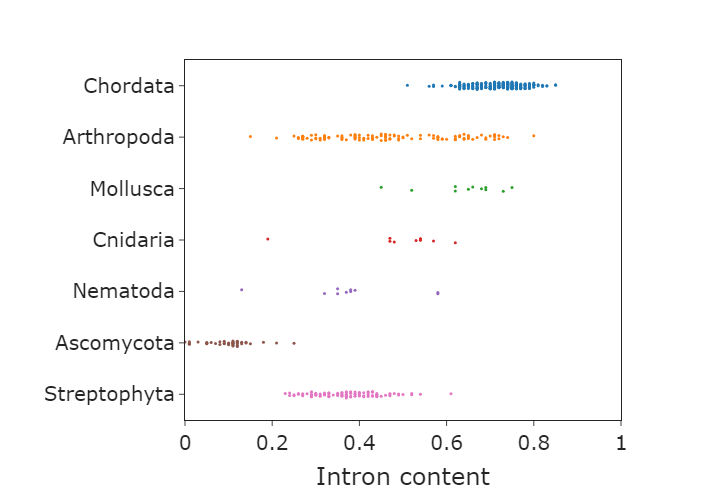

In [24]:
fig = px.strip(intron_len_stats_all_phyla10_df, y='phylum', x='Mean_intron_fraction',
               color='phylum', hover_data=['species'],
               height=500, width=800)

fig.update_layout(showlegend=False)
fig.update_xaxes(title='', tickfont={'size': 20})
fig.update_xaxes(title='Intron content', range=(0,1))
fig.update_yaxes(title='')
fig.update_traces(marker=dict(size=3))
fig.show()

In [25]:
fig_name = 'fig_1b'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)

/groups/itay_mayrose/liorglic/miniconda3/envs/jupyterlab/lib/python3.10/site-packages/plotly/express/_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



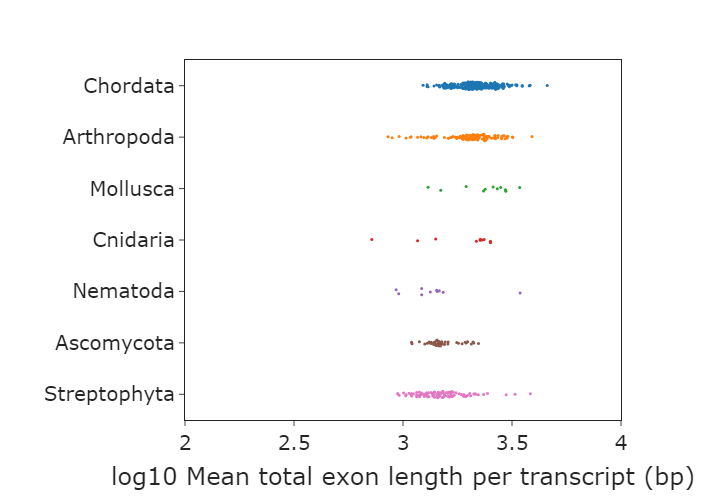

In [26]:
fig = px.strip(intron_len_stats_all_phyla10_df, y='phylum', x='log_Mean_total_exon_length_per_transcript',
               color='phylum', hover_data=['species'],
               height=500, width=800)

fig.update_layout(showlegend=False)
fig.update_xaxes(title='', tickfont={'size': 20})
fig.update_xaxes(title='log10 Mean total exon length per transcript (bp)', range=(2,4))
fig.update_yaxes(title='')
fig.update_traces(marker=dict(size=3))
fig.show()

In [27]:
fig_name = 'fig_1c'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)

In [28]:
intron_len_stats_all_phyla10_df['log_Mean_total_intron_length_per_transcript'] = np.log10(intron_len_stats_all_phyla10_df['Mean_total_intron_length_per_transcript'])

/var/tmp/pbs.275422.power9.tau.ac.il/ipykernel_13224/3978815334.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



/groups/itay_mayrose/liorglic/miniconda3/envs/jupyterlab/lib/python3.10/site-packages/plotly/express/_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



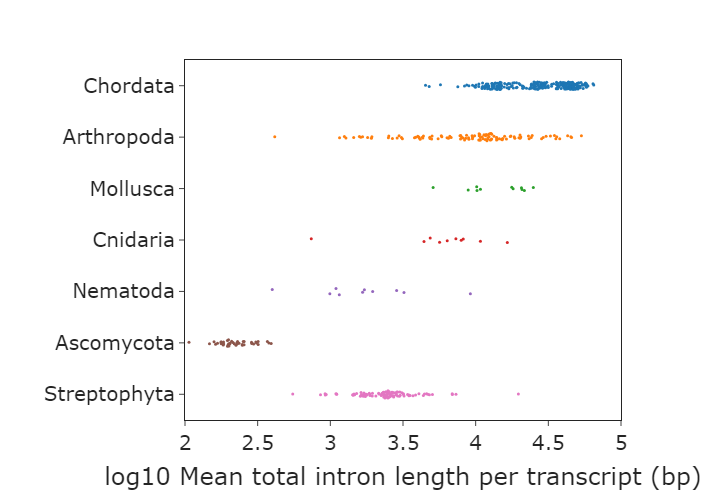

In [29]:
fig = px.strip(intron_len_stats_all_phyla10_df, y='phylum', x='log_Mean_total_intron_length_per_transcript',
               color='phylum', hover_data=['species'],
               height=500, width=800)

fig.update_layout(showlegend=False)
fig.update_xaxes(title='', tickfont={'size': 20})
fig.update_xaxes(title='log10 Mean total intron length per transcript (bp)', range=(2,5))
fig.update_yaxes(title='')
fig.update_traces(marker=dict(size=3))
fig.show()

In [30]:
fig_name = 'fig_1d'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)

/groups/itay_mayrose/liorglic/miniconda3/envs/jupyterlab/lib/python3.10/site-packages/plotly/express/_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



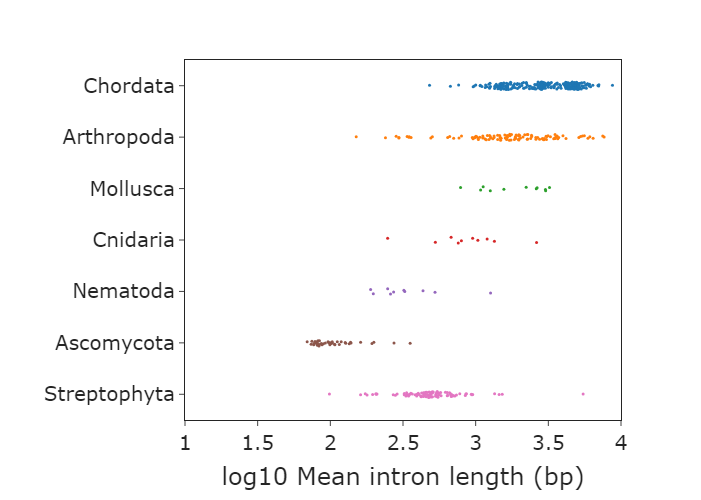

In [31]:
fig = px.strip(intron_len_stats_all_phyla10_df, y='phylum', x='log_Mean',
               color='phylum', hover_data=['species'],
               height=500, width=800)

fig.update_layout(showlegend=False)
fig.update_xaxes(title='', tickfont={'size': 20})
fig.update_xaxes(title='log10 Mean intron length (bp)', range=(1,4))
fig.update_yaxes(title='')
fig.update_traces(marker=dict(size=3))
fig.show()

In [32]:
fig_name = 'fig_1e'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)

/groups/itay_mayrose/liorglic/miniconda3/envs/jupyterlab/lib/python3.10/site-packages/plotly/express/_core.py:2044: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



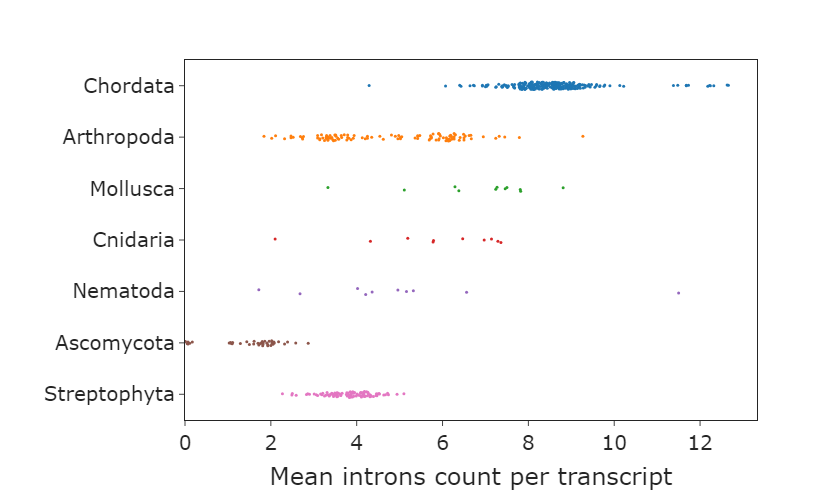

In [33]:
fig = px.strip(intron_len_stats_all_phyla10_df, y='phylum', x='Mean_per_transcript',
               color='phylum', hover_data=['species'],
               height=500, width=800)

fig.update_layout(showlegend=False)
fig.update_xaxes(title='', tickfont={'size': 20})
fig.update_xaxes(title='Mean introns count per transcript')
fig.update_yaxes(title='')
fig.update_traces(marker=dict(size=3))
fig.show()

In [34]:
fig_name = 'fig_1f'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)

## Phylogenetic conservation
Based on pairwise similarity between gene structure feature distributions, using the KS statistic as a measure.

In [35]:
phyla10_tree = "euk_tree_phyla10.nwk"
phyla10_tree = Tree(phyla10_tree, format=1)

In [36]:
len(phyla10_tree)

522

In [37]:
species_order = [l.name for l in phyla10_tree]
species_order_dict = {v: k for k, v in dict(enumerate(species_order)).items()}

In [38]:
species_phyla = intron_len_stats_all_phyla10_df.loc[species_order]['phylum']
species_phyla = species_phyla.value_counts()[species_phyla.unique()]

In [39]:
phyla_colors = dict(zip(phy_order, template_colors))

In [110]:
def plot_ks_heatmap(ks_distance_matrix_tsv, title=''):
    ks_distance_matrix = pd.read_csv(ks_distance_matrix_tsv, sep='\t', index_col=0)
    # convert full species names to binomial names
    spec_name_map = intron_len_stats_all_phyla10_df['full_name']
    spec_name_map = spec_name_map.loc[species_order]
    spec_name_map =pd.Series(spec_name_map.index.values, index=spec_name_map )
    ks_distance_matrix.index = ks_distance_matrix.index.map(spec_name_map)
    ks_distance_matrix.columns = ks_distance_matrix.columns.map(spec_name_map)

    # remove species not in the phylogeny (having NaN index or column)
    ks_distance_matrix = ks_distance_matrix[ks_distance_matrix.index.notnull()]
    ks_distance_matrix = ks_distance_matrix.loc[:, ks_distance_matrix.columns.notna()]

    # sort by order on phylogeny
    ks_distance_matrix.sort_index(key=lambda s: s.map(species_order_dict), inplace=True)
    ks_distance_matrix = ks_distance_matrix[sorted(ks_distance_matrix.columns, key=lambda s: species_order_dict[s])]

    fig = px.imshow(ks_distance_matrix, height=600, width=600)
    fig.update_xaxes(showticklabels=False, title_text='', visible=False)
    fig.update_yaxes(showticklabels=False, title_text='', visible=False)
        
    i = 0
    for phy, c in zip(species_phyla.index, species_phyla):
        fig.add_shape(type="line",
            x0=-10, y0=i, x1=-10, y1=i+c-1,
                      line_color=phyla_colors[phy],
                      opacity=1, line_width=4
        )
        fig.add_shape(type="line",
            x0=i, y0=-10, x1=i+c-1, y1=-10,
                      line_color=phyla_colors[phy],
                      opacity=1, line_width=4
        )    
        i += c
    
    fig.update_layout(title=title, coloraxis_colorbar={"title": 'KS distance'})
    return fig

In [111]:
intron_content_ks_matrix = os.path.join(wd, 'all_species/intron_fractions_KS_dist.tsv')
fig = plot_ks_heatmap(intron_content_ks_matrix, 'Intron content')

In [112]:
fig_name = 'fig_3a'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)

In [113]:
intron_content_ks_matrix = os.path.join(wd, 'all_species/intron_lengths_KS_dist.tsv')
fig = plot_ks_heatmap(intron_content_ks_matrix, 'Intron length')

In [114]:
fig_name = 'fig_3b'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)

In [115]:
intron_content_ks_matrix = os.path.join(wd, 'all_species/intron_counts_KS_dist.tsv')
fig = plot_ks_heatmap(intron_content_ks_matrix, 'Intron count')

In [116]:
fig_name = 'fig_3c'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)

## Evolutionary trajectories

In [41]:
phyla10_tree = "euk_tree_phyla10_anc_frac.nwk"
phyla10_tree = Tree(phyla10_tree, format=1)

In [68]:
from intervaltree import IntervalTree, Interval

def lin_eq(x1,y1,x2,y2):
    m = (y2-y1)/(x2-x1)
    b = y1 - m*x1
    return lambda x: m*x+b

def tree_to_intervals(tree, column, groups={}):   
    
    branches_iv = IntervalTree()

    # find MRCAs of groups
    group_mrcas = {}
    for gr in groups:
        group_mrcas[gr] = tree.get_common_ancestor(groups[gr])
        
    for node in tree.traverse():
        if node.is_root():
            continue
        parent = node.up
        node_height = node.get_distance(tree)
        parent_height = parent.get_distance(tree)
        if node_height == parent_height:
            continue
        if node.is_leaf():
            sp = node.name
            node_val = intron_len_stats_all_phyla10_df.query('species == @sp')[column].iloc[0]
        else:
            node_val = float(node.name)
        parent_val = float(parent.name)
        branch_lin_eq = lin_eq(parent_height,parent_val,node_height,node_val)

        # assign branch to group
        #branch_group = 'NA'
        branch_group = f'{parent_height}-{node_height}'
        for gr in group_mrcas:
            if parent == group_mrcas[gr] or parent in group_mrcas[gr]:
                branch_group = gr
                break
        
        branches_iv[parent_height:node_height] = {'group': branch_group, 'model': branch_lin_eq}
    return branches_iv

In [69]:
def median_at_point(branches_iv, h):
    branches = branches_iv[h]
    values = {}
    for b in branches:
        br_group = b.data['group']
        if br_group not in values:
            values[br_group] = []
        values[br_group].append(b.data['model'](h))
        
    for br_group in values:
        values[br_group] = pd.Series(values[br_group]).median()
        
    return values

In [70]:
species_in_tree = [t.name for t in phyla10_tree.get_leaves()]
intron_len_stats_all_phyla10_df_tree = intron_len_stats_all_phyla10_df.loc[intron_len_stats_all_phyla10_df['species'].isin(species_in_tree)]
phyla10_species = intron_len_stats_all_phyla10_df_tree.groupby('phylum')['species'].apply(list).to_dict()

/var/tmp/pbs.275422.power9.tau.ac.il/ipykernel_13224/1697913078.py:3: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



In [71]:
tree_iv = tree_to_intervals(phyla10_tree, 'Mean_intron_fraction', phyla10_species)

In [89]:
res = []
for h in np.arange(0,1600,5):
    h_values = pd.DataFrame.from_dict(median_at_point(tree_iv, h), orient='index').reset_index()
    h_values.columns = ['group','mean_at_height']
    h_values['height'] = h
    res.append(h_values)
res = pd.concat(res)

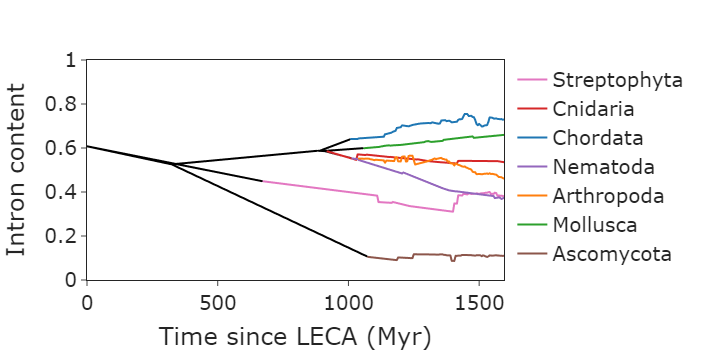

In [98]:
fig = px.line(res, x='height', y='mean_at_height', color='group')
for trace in fig.data:
    if trace.name in phyla_colors:
        trace.line['color'] = phyla_colors[trace.name]
    else:
        trace.line['color'] = 'black'
        trace.showlegend = False
fig.update_xaxes(title='Time since LECA (Myr)')
fig.update_yaxes(title='Intron content', range=(0,1))
fig.update_layout(legend_title_text='', plot_bgcolor = "rgba(0,0,0,0)", paper_bgcolor = "rgba(0,0,0,0)")
        
fig.show()

In [99]:
fig_name = 'fig_2b'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)

In [100]:
phyla10_tree = "euk_tree_phyla10_anc_length.nwk"
phyla10_tree = Tree(phyla10_tree, format=1)
tree_iv = tree_to_intervals(phyla10_tree, 'log_Mean', phyla10_species)
res = []
for h in np.arange(0,1600,5):
    h_values = pd.DataFrame.from_dict(median_at_point(tree_iv, h), orient='index').reset_index()
    h_values.columns = ['group','mean_at_height']
    h_values['height'] = h
    res.append(h_values)
res = pd.concat(res)

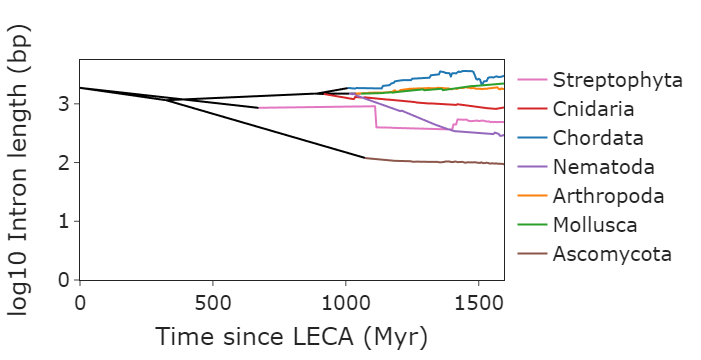

In [102]:
fig = px.line(res, x='height', y='mean_at_height', color='group')
for trace in fig.data:
    if trace.name in phyla_colors:
        trace.line['color'] = phyla_colors[trace.name]
    else:
        trace.line['color'] = 'black'
        trace.showlegend = False
fig.update_xaxes(title='Time since LECA (Myr)')
fig.update_yaxes(title='log10 Intron length (bp)')
fig.update_layout(legend_title_text='', plot_bgcolor = "rgba(0,0,0,0)", paper_bgcolor = "rgba(0,0,0,0)")
        
fig.show()

In [104]:
phyla10_tree = "euk_tree_phyla10_anc_count.nwk"
phyla10_tree = Tree(phyla10_tree, format=1)
tree_iv = tree_to_intervals(phyla10_tree, 'Mean_per_transcript', phyla10_species)
res = []
for h in np.arange(0,1600,5):
    h_values = pd.DataFrame.from_dict(median_at_point(tree_iv, h), orient='index').reset_index()
    h_values.columns = ['group','mean_at_height']
    h_values['height'] = h
    res.append(h_values)
res = pd.concat(res)

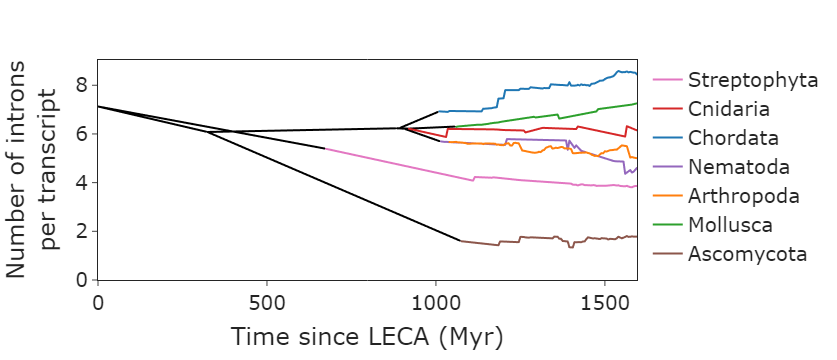

In [106]:
fig = px.line(res, x='height', y='mean_at_height', color='group')
for trace in fig.data:
    if trace.name in phyla_colors:
        trace.line['color'] = phyla_colors[trace.name]
    else:
        trace.line['color'] = 'black'
        trace.showlegend = False
fig.update_xaxes(title='Time since LECA (Myr)')
fig.update_yaxes(title='Number of introns<br>per transcript')
fig.update_layout(legend_title_text='', plot_bgcolor = "rgba(0,0,0,0)", paper_bgcolor = "rgba(0,0,0,0)")
        
fig.show()

## Intron length modality

In [44]:
def simplify_modes(x):
    if x <= 2:
        return str(int(x))
    return '3+'
    
intron_len_stats_all_log_phyla10_df['Modes_simp'] = intron_len_stats_all_log_phyla10_df['Modes'].apply(simplify_modes)

intron_len_stats_all_log_phyla10_df['Modes_simp'] = pd.Categorical(intron_len_stats_all_log_phyla10_df['Modes_simp'], ['1','2','3+'])

/var/tmp/pbs.65419.power9.tau.ac.il/ipykernel_59858/3395977641.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/tmp/pbs.65419.power9.tau.ac.il/ipykernel_59858/3395977641.py:8: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [45]:
# sort by phylum order
intron_len_stats_all_log_phyla10_df['phylum'] = pd.Categorical(intron_len_stats_all_log_phyla10_df['phylum'], phy_order)
intron_len_stats_all_log_phyla10_df.sort_values(by='phylum', inplace=True)

/var/tmp/pbs.65419.power9.tau.ac.il/ipykernel_59858/1379367000.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/tmp/pbs.65419.power9.tau.ac.il/ipykernel_59858/1379367000.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [46]:
def main_mode(row):
    if row['Modes_simp'] != '2':
        return 'NA'
    elif row['M1_x'] < row['M2_x']:
        return 'Left'
    else:
        return 'Right'
        
intron_len_stats_all_log_phyla10_df['main_mode'] = intron_len_stats_all_log_phyla10_df.apply(main_mode, axis=1)

/var/tmp/pbs.65419.power9.tau.ac.il/ipykernel_59858/1016172529.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [47]:
intron_len_stats_all_log_phyla10_df.sort_values(by=['phylum', 'Modes_simp', 'main_mode'], inplace=True)

/var/tmp/pbs.65419.power9.tau.ac.il/ipykernel_59858/1688232327.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



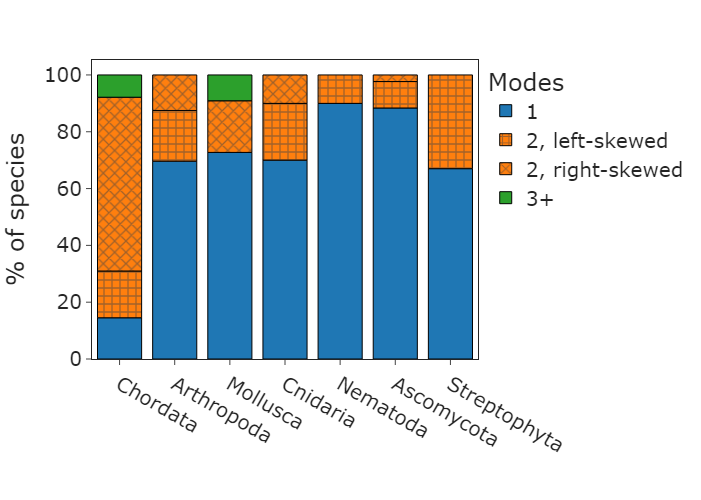

In [48]:
fig = px.histogram(intron_len_stats_all_log_phyla10_df, x='phylum', color='Modes_simp',
                   pattern_shape='main_mode', pattern_shape_sequence=['','+','x'],
                   barnorm='percent',
                  category_orders={'Modes_simp': ['1','2','3+']}, height=500, width=800)
fig.update_xaxes(title='')
fig.update_yaxes(title='% of species')
fig.update_layout(legend_title_text='Modes')
#fig.update_traces(marker_line_width=1,marker_line_color="black")
fig.update_traces(  
    marker=dict(line_width=1, line_color="black", pattern_fillmode="overlay")
)
rename = {'1, NA': '1',
         '3+, NA': '3+',
         '2, Left': '2, left-skewed',
         '2, Right': '2, right-skewed'}
fig.for_each_trace(lambda t: t.update(name = rename[t.name],
                                      legendgroup = rename[t.name],
                                      hovertemplate = t.hovertemplate.replace(t.name, rename[t.name])
                                     )
                  )
fig.show()

In [49]:
fig_name = 'fig_1f'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)

In [50]:
intron_len_stats_all_log_phyla10_2modes_df = intron_len_stats_all_log_phyla10_df.query('Modes == 2')
intron_len_stats_all_log_phyla10_2modes_df['main_mode'] = (intron_len_stats_all_log_phyla10_2modes_df['M1_x'] < intron_len_stats_all_log_phyla10_2modes_df['M2_x']).map({True: 'Left', False: 'Right'})

/var/tmp/pbs.65419.power9.tau.ac.il/ipykernel_59858/3253955912.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



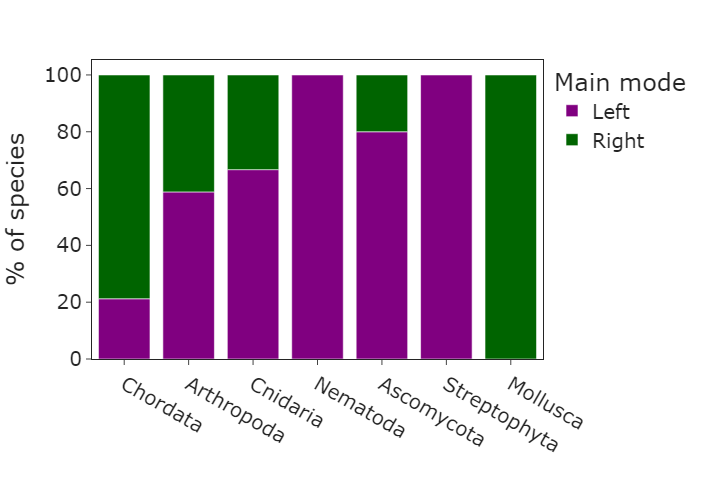

In [51]:
fig = px.histogram(intron_len_stats_all_log_phyla10_2modes_df, x='phylum', color='main_mode', barnorm='percent', height=500, width=800, color_discrete_sequence=['purple', 'darkgreen']
                  )
fig.update_xaxes(title='')
fig.update_yaxes(title='% of species')
fig.update_layout(legend_title_text='Main mode')
fig.show()

In [52]:
intron_len_stats_all_phyla10_df['log2_mean_max_to_min_intron_ratio'] = np.log2(intron_len_stats_all_phyla10_df['mean_max_to_min_intron_ratio'])

/var/tmp/pbs.65419.power9.tau.ac.il/ipykernel_59858/2309811983.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



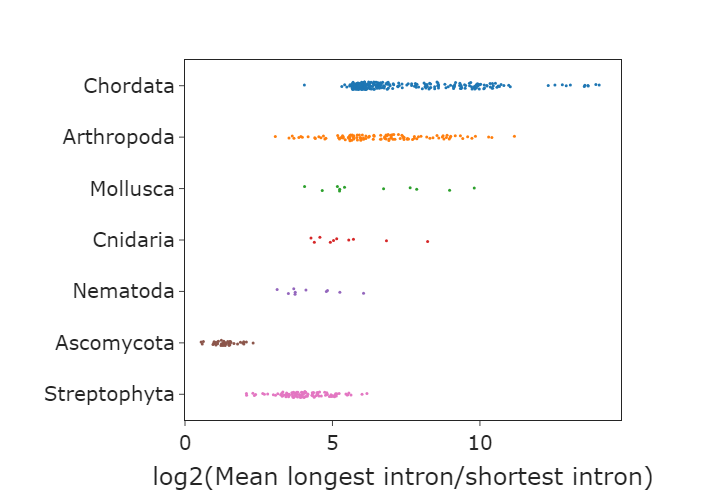

In [53]:
fig = px.strip(intron_len_stats_all_phyla10_df, y='phylum', x='log2_mean_max_to_min_intron_ratio',
               color='phylum',
               height=500, width=800)

fig.update_layout(showlegend=False)
fig.update_xaxes(title='', tickfont={'size': 20})
fig.update_xaxes(title='log2(Mean longest intron/shortest intron)')
fig.update_yaxes(title='')
fig.update_traces(marker=dict(size=3))
fig.show()

In [54]:
fig_name = 'fig_2a'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)

In [55]:
intron_len_stats_all_phyla10_df.query('mean_max_to_min_intron_ratio_perm_p > 0.05')['phylum'].value_counts()

phylum
Arthropoda      5
Ascomycota      3
Streptophyta    3
Mollusca        1
Cnidaria        1
Chordata        0
Nematoda        0
Name: count, dtype: int64

In [56]:
intron_len_stats_all_phyla10_df['log2_mean_first_to_max_nonfirst_intron_ratio'] = np.log2(intron_len_stats_all_phyla10_df['mean_first_to_max_nonfirst_intron_ratio'])

/var/tmp/pbs.65419.power9.tau.ac.il/ipykernel_59858/1322809504.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



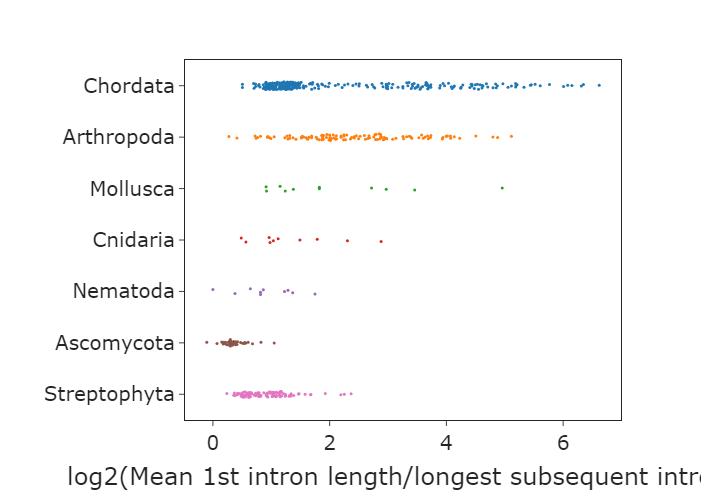

In [57]:
fig = px.strip(intron_len_stats_all_phyla10_df, y='phylum', x='log2_mean_first_to_max_nonfirst_intron_ratio',
               color='phylum',
               height=500, width=800)

fig.update_layout(showlegend=False)
fig.update_xaxes(title='', tickfont={'size': 20})
fig.update_xaxes(title='log2(Mean 1st intron length/longest subsequent intron)')
fig.update_yaxes(title='')
fig.update_traces(marker=dict(size=3))
fig.show()

In [58]:
fig_name = 'fig_2b'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)

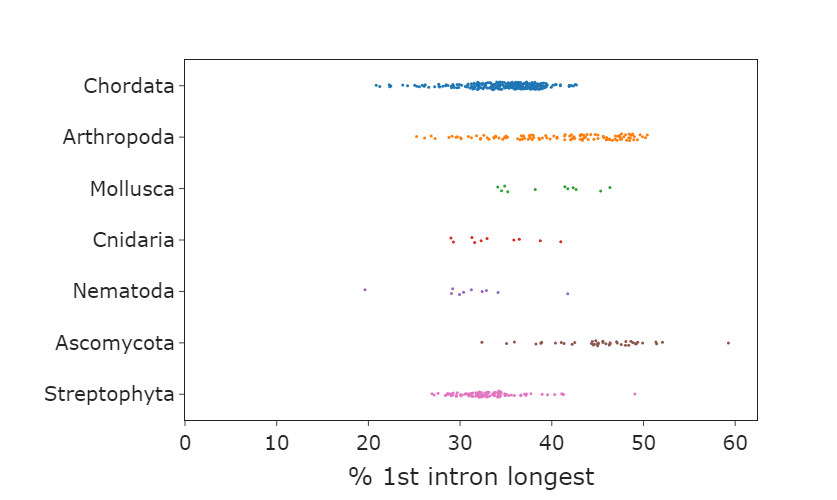

In [59]:
fig = px.strip(intron_len_stats_all_phyla10_df, y='phylum', x='perc_first_intron_longest',
               color='phylum',
               height=500, width=800)

fig.update_layout(showlegend=False)
fig.update_xaxes(title='', tickfont={'size': 20})
fig.update_xaxes(title='% 1st intron longest')
fig.update_yaxes(title='')
fig.update_traces(marker=dict(size=3))
fig.show()

In [60]:
fig_name = 'fig_2c'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)

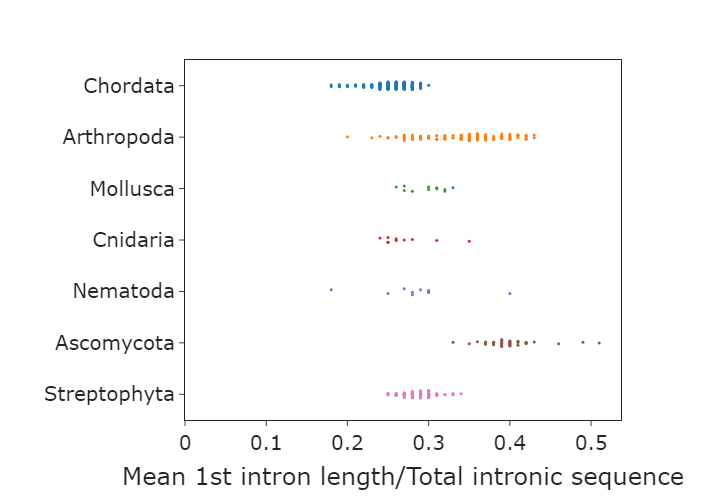

In [61]:
fig = px.strip(intron_len_stats_all_phyla10_df, y='phylum', x='mean_first_from_total_intronic_ratio',
               color='phylum',
               height=500, width=800)

fig.update_layout(showlegend=False)
fig.update_xaxes(title='', tickfont={'size': 20})
fig.update_xaxes(title='Mean 1st intron length/Total intronic sequence')
fig.update_yaxes(title='')
fig.update_traces(marker=dict(size=3))
fig.show()

In [62]:
fig_name = 'fig_2d'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)

In [70]:
def ks_dist(row):
    s1 = row['species1']
    s2 = row['species2']
    return ks_distance_matrix.loc[s1,s2]

def tree_dist(row):
    s1 = row['species1']
    s2 = row['species2']
    return round(phyla10_tree.get_distance(s1, s2))

res = pd.DataFrame()
for phy in phy_order:
    print(phy)
    phy_stats_df = intron_len_stats_all_phyla10_df.query('phylum == @phy')
    phy_species = set(phy_stats_df.index)
    phy_species = phy_species.intersection(set(species_order))
    if not phy_species:
        continue
    all_pairs = list(combinations(phy_species, 2))
    phyl_df = pd.DataFrame()
    phyl_df['species1'] = pd.Series([p[0] for p in all_pairs])
    phyl_df['species2'] = pd.Series([p[1] for p in all_pairs])
    phyl_df['tree_distance'] = phyl_df.apply(tree_dist, axis=1)
    phyl_df['KS'] = phyl_df.apply(ks_dist, axis=1)
    phyl_df = phyl_df.groupby('tree_distance')[['KS']].mean().reset_index()
    phyl_df['phylum'] = phy
    res = pd.concat([res, phyl_df])

Chordata
Arthropoda
Mollusca
Cnidaria
Nematoda
Ascomycota
Streptophyta


In [71]:
colors = [phyla_colors[phy] for phy in res['phylum'].unique()]
fig = px.scatter(res, x='tree_distance', y='KS', color='phylum', color_discrete_sequence=colors,
                height=500, width=800)
fig.update_xaxes(title='Evolutionary distance (Myr)')
fig.update_yaxes(title='KS')
fig.update_layout(legend_title_text='')
fig.show()

In [72]:
fig_name = 'fig_3b'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)

Repeat using a simpler similarity measure - the absolute difference of mean intron length.

In [73]:
diff_matrix = ks_distance_matrix.applymap(lambda x: np.nan)
for pair in combinations(diff_matrix.index,2):
    s1, s2 = pair
    diff = abs(intron_len_stats_all_phyla10_df.loc[s1]['log_Mean'] - intron_len_stats_all_phyla10_df.loc[s2]['log_Mean'])
    diff_matrix.loc[s1,s2] = diff
    diff_matrix.loc[s2,s1] = diff
    diff_matrix.loc[s1,s1] = 0

In [74]:
fig = px.imshow(diff_matrix, height=600, width=600)
fig.update_xaxes(showticklabels=False, title_text='', visible=False)
fig.update_yaxes(showticklabels=False, title_text='', visible=False)


i = 0
for phy, c in zip(species_phyla.index, species_phyla):
    fig.add_shape(type="line",
        x0=-10, y0=i, x1=-10, y1=i+c-1,
                  line_color=phyla_colors[phy],
                  opacity=1, line_width=4
    )
    fig.add_shape(type="line",
        x0=i, y0=-10, x1=i+c-1, y1=-10,
                  line_color=phyla_colors[phy],
                  opacity=1, line_width=4
    )    

    i += c

#fig.update_layout(legend_title_text='log10 Mean intron length difference')
fig.show()

In [75]:
fig_name = 'fig_S4a'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)

In [76]:
def mean_intron_diff(row):
    s1 = row['species1']
    s2 = row['species2']
    return diff_matrix.loc[s1,s2]

res = pd.DataFrame()
for phy in phy_order:
    print(phy)
    phy_stats_df = intron_len_stats_all_phyla10_df.query('phylum == @phy')
    phy_species = set(phy_stats_df.index)
    phy_species = phy_species.intersection(set(species_order))
    if not phy_species:
        continue
    all_pairs = list(combinations(phy_species, 2))
    phyl_df = pd.DataFrame()
    phyl_df['species1'] = pd.Series([p[0] for p in all_pairs])
    phyl_df['species2'] = pd.Series([p[1] for p in all_pairs])
    phyl_df['tree_distance'] = phyl_df.apply(tree_dist, axis=1)
    phyl_df['diff'] = phyl_df.apply(mean_intron_diff, axis=1)
    phyl_df = phyl_df.groupby('tree_distance')[['diff']].mean().reset_index()
    phyl_df['phylum'] = phy
    res = pd.concat([res, phyl_df])

Chordata
Arthropoda
Mollusca
Cnidaria
Nematoda
Ascomycota
Streptophyta


In [77]:
colors = [phyla_colors[phy] for phy in res['phylum'].unique()]
fig = px.scatter(res, x='tree_distance', y='diff', color='phylum', color_discrete_sequence=colors,
                height=500, width=800)
fig.update_xaxes(title='Evolutionary distance (Myr)')
fig.update_yaxes(title=u'\u0394'+' Mean intron length')
fig.update_layout(legend_title_text='')
fig.show()

In [ ]:
fig_name = 'fig_S4b'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)

In [78]:
colors = [phyla_colors[phy] for phy in res['phylum'].unique()]
fig = px.scatter(res, x='tree_distance', y='diff', color='phylum', color_discrete_sequence=colors,
                height=500, width=800, trendline='ols')
fig.update_xaxes(title='Evolutionary distance (Myr)')
fig.update_yaxes(title=u'\u0394'+' Mean intron length')
fig.update_layout(legend_title_text='')
fig.show()

In [87]:
results = px.get_trendline_results(fig)
results.query('phylum == "Arthropoda"').px_fit_results.iloc[0].summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.321
Model:                            OLS   Adj. R-squared:                  0.315
Method:                 Least Squares   F-statistic:                     46.44
Date:                Wed, 16 Aug 2023   Prob (F-statistic):           7.74e-10
Time:                        15:21:03   Log-Likelihood:                 32.092
No. Observations:                 100   AIC:                            -60.18
Df Residuals:                      98   BIC:                            -54.97
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.1062      0.028      3.825      0.000       0.051       0.161
x1             0.0004   5.63e-05      6.814      0.000       0.000       0.000
==============================================================================
Omnibus:                       18.420   Durbin-Watson:                   2.120
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               22.025
Skew:                           1.112   Prob(JB):                     1.65e-05
Kurtosis:                       3.581   Cond. No.                         772.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

## Evolutionary change
Analyze total change in mean intron length, in nodes 'under' and 'above' phyla MRCAs.

In [4]:
br_len_rates_df = pd.read_csv('br_len_rates.tsv', sep='\t')
br_len_rates_df['change'] = br_len_rates_df['branch_length'] * br_len_rates_df['Rate']

In [5]:
total_br_len = br_len_rates_df.groupby(['phylum','type'])['branch_length'].sum()
total_minus = br_len_rates_df.query('Rate < 0').groupby(['phylum','type'])['change'].sum()
total_plus = br_len_rates_df.query('Rate > 0').groupby(['phylum','type'])['change'].sum()
change_df = pd.concat([total_br_len, total_minus, total_plus], axis=1)
change_df.columns = ['Total_branch_length','Total_minus','Total_plus']
change_df = change_df.fillna(0)

In [6]:
change_df

Total_branch_length  Total_minus  Total_plus
phylum       type                                               
Arthropoda   above            166.97400    -0.019194    0.017860
             under          21217.42273    -3.935630    4.933197
Ascomycota   above             29.28622    -0.006783    0.000000
             under           5332.04758    -0.671406    0.826792
Chordata     above            145.85272    -0.003288    0.004193
             under          21723.79492    -8.099760    8.191331
Cnidaria     above             75.90102    -0.003288    0.001378
             under            696.63143    -0.058972    0.039380
Mollusca     above            122.53575    -0.004852    0.026065
             under           3022.15668    -0.201256    0.286990
Nematoda     above            102.44080    -0.011854    0.000588
             under          25365.37513    -5.079481    6.204312
Streptophyta above             86.95932    -0.013035    0.002996
             under           5419.78020   -15.294016   10.207751

In [7]:
change_df.to_csv('Table_S3.tsv', sep='\t')

In [8]:
change_df.index.get_level_values(0)

Index(['Arthropoda', 'Arthropoda', 'Ascomycota', 'Ascomycota', 'Chordata',
       'Chordata', 'Cnidaria', 'Cnidaria', 'Mollusca', 'Mollusca', 'Nematoda',
       'Nematoda', 'Streptophyta', 'Streptophyta'],
      dtype='object', name='phylum')

In [28]:
change_norm_df = change_df.copy()

change_norm_df['Reduction'] = change_norm_df['Total_minus'] / change_norm_df['Total_branch_length'] * 1000
change_norm_df['Inflation'] = change_norm_df['Total_plus'] / change_norm_df['Total_branch_length'] * 1000
change_norm_df['Overall change'] = change_norm_df['Reduction'] + change_norm_df['Inflation']
change_norm_df['Phylum'] = change_norm_df.index.get_level_values(0)
change_norm_df['Type'] = change_norm_df.index.get_level_values(1)
change_norm_df = change_norm_df.reset_index(drop=True)
change_norm_df['Phylum'] = pd.Categorical(change_norm_df['Phylum'], phy_order)
change_norm_df.sort_values(by='Phylum', inplace=True)

change_norm_df

,Total_branch_length,Total_minus,Total_plus,Reduction,Inflation,Overall change,Phylum,Type
4,145.85272,-0.003288,0.004193,-0.022546,0.028745,0.006199,Chordata,above
5,21723.79492,-8.099760,8.191331,-0.372852,0.377067,0.004215,Chordata,under
0,166.97400,-0.019194,0.017860,-0.114955,0.106965,-0.007989,Arthropoda,above
1,21217.42273,-3.935630,4.933197,-0.185490,0.232507,0.047016,Arthropoda,under
8,122.53575,-0.004852,0.026065,-0.039595,0.212711,0.173116,Mollusca,above
9,3022.15668,-0.201256,0.286990,-0.066594,0.094962,0.028369,Mollusca,under
6,75.90102,-0.003288,0.001378,-0.043325,0.018151,-0.025174,Cnidaria,above
7,696.63143,-0.058972,0.039380,-0.084653,0.056529,-0.028124,Cnidaria,under
10,102.44080,-0.011854,0.000588,-0.115718,0.005737,-0.109981,Nematoda,above
11,25365.37513,-5.079481,6.204312,-0.200253,0.244598,0.044345,Nematoda,under


In [29]:
change_norm_df = change_df.copy()

change_norm_df['Reduction'] = change_norm_df['Total_minus'] / change_norm_df['Total_branch_length'] * 1000
change_norm_df['Inflation'] = change_norm_df['Total_plus'] / change_norm_df['Total_branch_length'] * 1000
change_norm_df['Overall change'] = change_norm_df['Reduction'] + change_norm_df['Inflation']
change_norm_df['Phylum'] = change_norm_df.index.get_level_values(0)
change_norm_df['Type'] = change_norm_df.index.get_level_values(1)
change_norm_df = change_norm_df.reset_index(drop=True)

change_norm_df['Phylum'] = pd.Categorical(change_norm_df['Phylum'], phy_order)
change_norm_df.sort_values(by='Phylum', inplace=True)

change_norm_df

,Total_branch_length,Total_minus,Total_plus,Reduction,Inflation,Overall change,Phylum,Type
4,145.85272,-0.003288,0.004193,-0.022546,0.028745,0.006199,Chordata,above
5,21723.79492,-8.099760,8.191331,-0.372852,0.377067,0.004215,Chordata,under
0,166.97400,-0.019194,0.017860,-0.114955,0.106965,-0.007989,Arthropoda,above
1,21217.42273,-3.935630,4.933197,-0.185490,0.232507,0.047016,Arthropoda,under
8,122.53575,-0.004852,0.026065,-0.039595,0.212711,0.173116,Mollusca,above
9,3022.15668,-0.201256,0.286990,-0.066594,0.094962,0.028369,Mollusca,under
6,75.90102,-0.003288,0.001378,-0.043325,0.018151,-0.025174,Cnidaria,above
7,696.63143,-0.058972,0.039380,-0.084653,0.056529,-0.028124,Cnidaria,under
10,102.44080,-0.011854,0.000588,-0.115718,0.005737,-0.109981,Nematoda,above
11,25365.37513,-5.079481,6.204312,-0.200253,0.244598,0.044345,Nematoda,under


In [30]:
# prep for plot
df_under = change_norm_df.query('Type == "under"')[['Reduction','Inflation','Overall change','Phylum']]
df_above = change_norm_df.query('Type == "above"')['Overall change'].to_frame()
plot_df = df_under.copy()
plot_df['Ancestral overall change'] = df_above['Overall change'].values
plot_df

,Reduction,Inflation,Overall change,Phylum,Ancestral overall change
5,-0.372852,0.377067,0.004215,Chordata,0.006199
1,-0.185490,0.232507,0.047016,Arthropoda,-0.007989
9,-0.066594,0.094962,0.028369,Mollusca,0.173116
7,-0.084653,0.056529,-0.028124,Cnidaria,-0.025174
11,-0.200253,0.244598,0.044345,Nematoda,-0.109981
3,-0.125919,0.155061,0.029142,Ascomycota,-0.231604
13,-2.821889,1.883425,-0.938463,Streptophyta,-0.115438


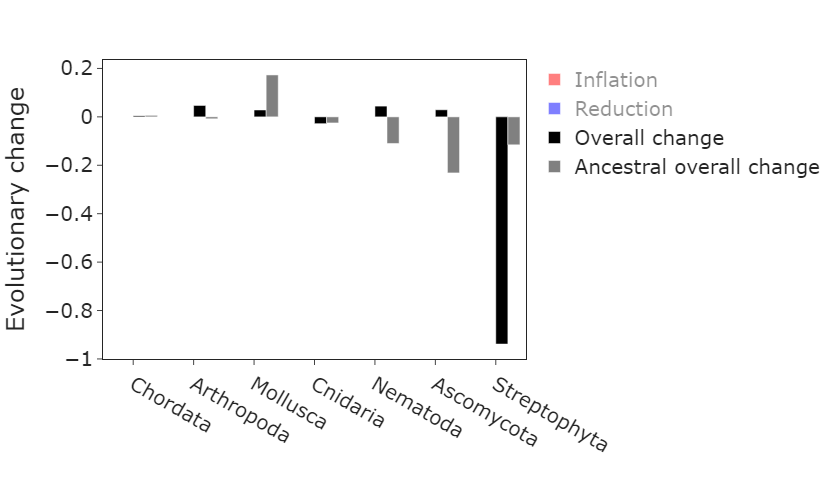

In [31]:
fig = px.bar(plot_df, x='Phylum', y=['Inflation','Reduction','Overall change', 'Ancestral overall change'],
             barmode='group', color_discrete_sequence=['red','blue','black', 'grey'],
             height=500, width=800)
fig.update_yaxes(title='Evolutionary change')
fig.update_xaxes(title='')
fig.update_layout(legend_title='')
fig.update 
fig.show()

In [89]:
fig_name = 'fig_4c'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)

## Intron length and Genome size

In [93]:
pgls_tsv = 'PGLS.tsv'
pgls_df = pd.read_csv(pgls_tsv, sep='\t', index_col=0)

In [94]:
pgls_df

,Intercept,Coefficient,R^2
All,0.000000,0.255856,0.146306
Arthropoda,-4.198567,0.843105,0.655336
Ascomycota,2.046339,0.000562,-0.025640
Chordata,-2.667482,0.669916,0.399236
Cnidaria,-7.384535,1.207635,0.873705
Mollusca,-4.065238,0.818176,0.815840
Nematoda,0.000000,0.737661,0.468742
Streptophyta,2.270321,0.088459,0.051607


In [118]:
def abline(intercept, slope, data, color):
    x_min = data.min()
    x_max = data.max()
    x = [x_min, x_max]
    y = [intercept + p*slope for p in x]
    return go.Scatter(x=x, y=y, mode='lines', line_color=color, showlegend=False)

In [119]:
fig = px.scatter(intron_len_stats_all_phyla10_df, x='log_Genome_size', y='log_Mean', color='phylum',
                height=500, width=800)
fig.update_xaxes(range=(6,11), title='log10 Genome size (bp)')
fig.update_yaxes(title='log10 Mean intron length (bp)')

# add PGLS model lines
for row in pgls_df.iterrows():
    phylum = row[0]
    if phylum == "Ascomycota":
        continue
    intercept = row[1][0]
    slope = row[1][2]
    if phylum == "All":
        color = 'black'
        phyl_data = intron_len_stats_all_phyla10_df['log_Genome_size']
    else:
        color = phyla_colors[phylum]
        phyl_data = intron_len_stats_all_phyla10_df.query('phylum == @phylum')['log_Genome_size']
    fig.add_trace(abline(intercept, slope, phyl_data, color))

fig.show()

In [120]:
fig_name = 'fig_5'
fig_path = os.path.join(figures_dir, fig_name + '.jpg')
fig.write_image(fig_path, scale=5)
fig_path = os.path.join(figures_dir, fig_name + '.pdf')
fig.write_image(fig_path, scale=5)